In [1]:
from nilearn import datasets
import nibabel as nib
import plotly.graph_objects as go
import numpy as np

In [2]:
data = datasets.fetch_development_fmri(n_subjects=1)
fmri_img = nib.load(data.func[0])
fmri_data = fmri_img.get_fdata()

[get_dataset_dir] Dataset found in /root/nilearn_data/development_fmri
[get_dataset_dir] Dataset found in /root/nilearn_data/development_fmri/development_fmri
[get_dataset_dir] Dataset found in /root/nilearn_data/development_fmri/development_fmri


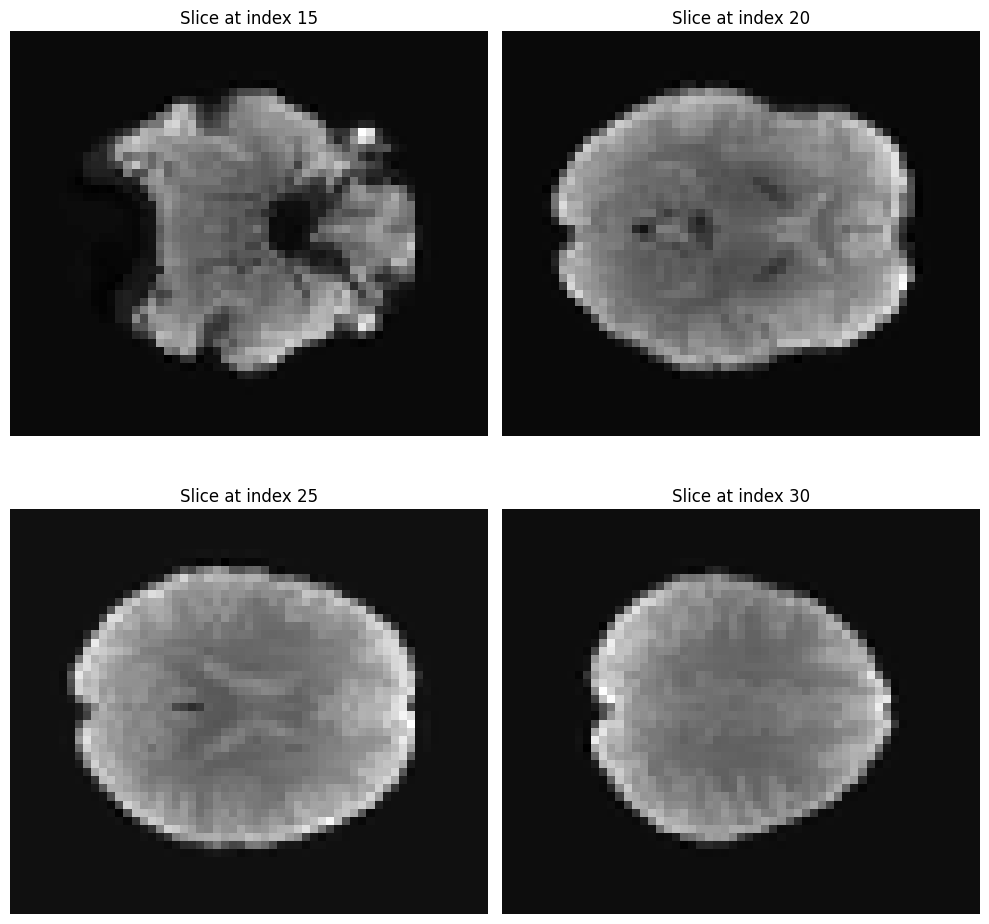

In [3]:
import matplotlib.pyplot as plt
import numpy as np
fig, axes = plt.subplots(2, 2, figsize=(10, 10))
slice_indices = [15, 20, 25, 30]
axes = axes.ravel()
for i, slice_index in enumerate(slice_indices):
    ax = axes[i]
    ax.imshow(fmri_data[:, :, slice_index, 0], cmap='gray')
    ax.set_title(f"Slice at index {slice_index}")
    ax.axis('off')
plt.tight_layout()
plt.show()

In [4]:
import numpy as np
import plotly.graph_objects as go
from plotly.subplots import make_subplots
x, y, z = np.mgrid[-1:1:50j, -1:1:50j, -1:1:50j]
brain_data1 = np.swapaxes(fmri_data[:,:,:,0], 0, 1)
brain_data2 = np.swapaxes(fmri_data[:,:,:,100], 0, 1)
fig = make_subplots(
    rows=2, cols=2,
    specs=[[{'type': 'scene'}, {'type': 'scene'}],
           [{'type': 'scene', 'colspan': 2}, None]],
    subplot_titles=('Time Point 0', 'Time Point 100', 'Overlaid View')
)
fig.add_trace(go.Isosurface(
    x=x.flatten(),
    y=y.flatten(),
    z=z.flatten(),
    value=brain_data1.flatten(),
    isomin=-700,
    isomax=np.max(brain_data1),
    surface_count=1,
    colorscale='Greys',
    showscale=False,
    caps=dict(x_show=False, y_show=False),
    name='Time Point 0'
), row=1, col=1)
fig.add_trace(go.Isosurface(
    x=x.flatten(),
    y=y.flatten(),
    z=z.flatten(),
    value=brain_data2.flatten(),
    isomin=-700,
    isomax=np.max(brain_data2),
    surface_count=1,
    colorscale='Greys',
    showscale=False,
    caps=dict(x_show=False, y_show=False),
    name='Time Point 100'
), row=1, col=2)
fig.add_trace(go.Isosurface(
    x=x.flatten(),
    y=y.flatten(),
    z=z.flatten(),
    value=brain_data1.flatten(),
    isomin=-700,
    isomax=np.max(brain_data1),
    surface_count=1,
    colorscale='Blues',
    name='Time Point 0 (Overlay)',
    showscale=False,
    opacity=0.5,
    caps=dict(x_show=False, y_show=False)
), row=2, col=1)
fig.add_trace(go.Isosurface(
    x=x.flatten(),
    y=y.flatten(),
    z=z.flatten(),
    value=brain_data2.flatten(),
    isomin=-700,
    isomax=np.max(brain_data2),
    surface_count=1,
    colorscale='Reds',
    name='Time Point 100 (Overlay)',
    showscale=False,
    opacity=0.1,
    caps=dict(x_show=False, y_show=False)
), row=2, col=1)
fig.update_layout(
    height=800,
    margin=dict(l=0, r=0, b=0, t=60),
    scene3 = dict(
        xaxis_title='X Axis',
        yaxis_title='Y Axis',
        zaxis_title='Z Axis'
    )
)
fig.show()